<a href="https://colab.research.google.com/github/wik34455/programmieren2_uebungen/blob/main/Test_1164_Bilder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.1/78.2 GB disk)


In [4]:
from ultralytics import YOLO
import os
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo checks

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.5/78.2 GB disk)

OS                  Linux-6.1.58+-x86_64-with-glibc2.35
Environment         Colab
Python              3.10.12
Install             pip
RAM                 12.67 GB
CPU                 Intel Xeon 2.30GHz
CUDA                12.1

matplotlib          ✅ 3.7.1>=3.3.0
opencv-python       ✅ 4.8.0.76>=4.6.0
pillow              ✅ 9.4.0>=7.1.2
pyyaml              ✅ 6.0.1>=5.3.1
requests            ✅ 2.31.0>=2.23.0
scipy               ✅ 1.11.4>=1.4.1
torch               ✅ 2.2.1+cu121>=1.8.0
torchvision         ✅ 0.17.1+cu121>=0.9.0
tqdm                ✅ 4.66.2>=4.64.0
psutil              ✅ 5.9.5
py-cpuinfo          ✅ 9.0.0
thop                ✅ 0.1.1-2209072238>=0.1.1
pandas              ✅ 2.0.3>=1.1.4
seaborn             ✅ 0.13.1>=0.11.0


In [1]:
#image wihtout data augmentation
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="HZ0zIRYpPJF2UWyewNIa")
project = rf.workspace("yolocustomdataset").project("face_recognition-shzau")
version = project.version(4)
dataset = version.download("yolov8")


ERROR: Operation cancelled by user
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 3108, in _dep_map
    return self.__dep_map
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 2901, in __getattr__
    raise AttributeError(attr)
AttributeError: _DistInfoDistribution__dep_map

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 169, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/req_command.py", line 242, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 441, in run
    conflicts = self._determine_conflicts(to_install)
  File "/usr/local/lib/python3.10/dist-packages/pip/_i

In [2]:
!yolo task=detect mode=train model=yolov8m.pt data={dataset.location}/data.yaml epochs=20 imgsz=640

100% 49.7M/49.7M [00:00<00:00, 216MB/s]
Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/Face_Recognition-4/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_c

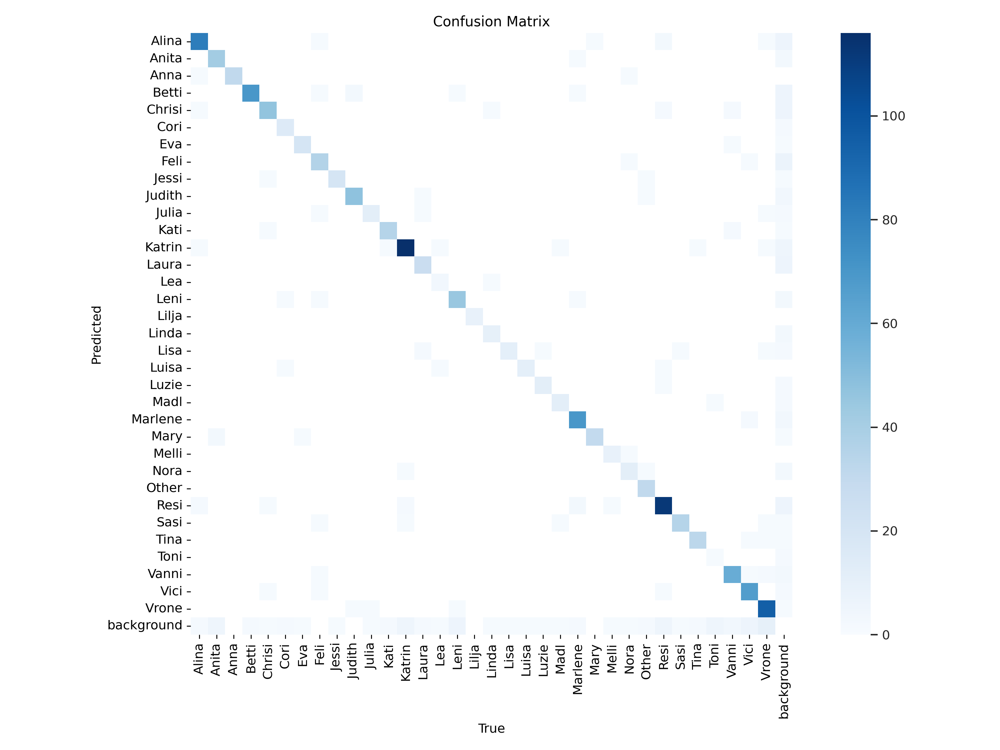

In [7]:
Image(filename=f'/content/runs/detect/train/confusion_matrix.png', width=600)

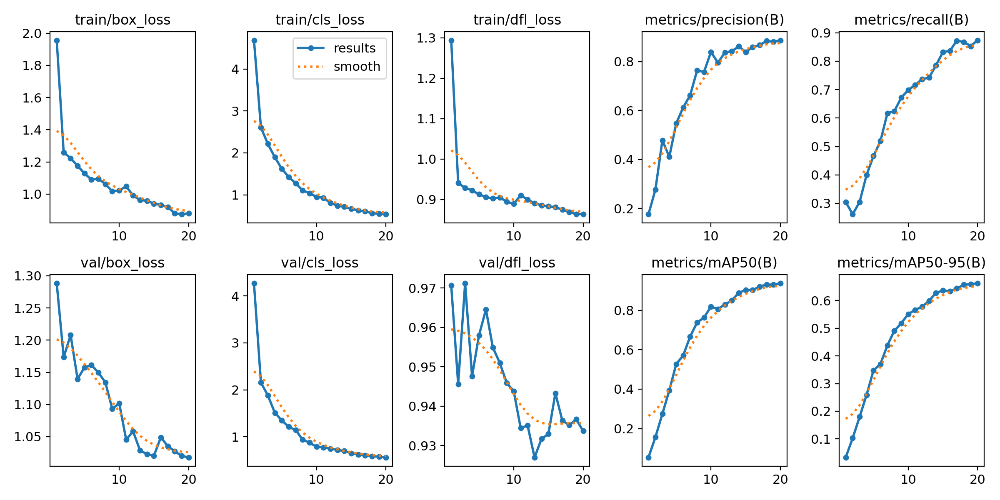

In [6]:
Image(filename=f'/content/runs/detect/train/results.png',width=600)

In [8]:
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25859446 parameters, 0 gradients, 78.8 GFLOPs
val: Scanning /content/Face_Recognition-4/valid/labels.cache... 233 images, 0 backgrounds, 0 corrupt: 100% 233/233 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 15/15 [00:13<00:00,  1.13it/s]
                   all        233       1432      0.885      0.878      0.936      0.664
                 Alina        233         89      0.888      0.944      0.957      0.696
                 Anita        233         50      0.993        0.9      0.972      0.664
                  Anna        233         31      0.925          1      0.991       0.64
                 Betti        233         72      0.874      0.972      0.981      0.663
                Chrisi        233         52      0.851      0.942      0.974      0.707
                  Cori        233        

In [44]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.3 source='/content/Face_Recognition-4/test/images' line_width=1

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25859446 parameters, 0 gradients, 78.8 GFLOPs

image 1/117 /content/Face_Recognition-4/test/images/Z61_2110_jpg.rf.fa50e15711fe3bdbbf2699b65bfc5cb4.jpg: 448x640 1 Alina, 1 Anita, 1 Betti, 2 Chrisis, 1 Feli, 1 Judith, 1 Katrin, 1 Leni, 1 Marlene, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 107.6ms
image 2/117 /content/Face_Recognition-4/test/images/Z61_2111_jpg.rf.5a3b9c02b91113bca8e5df8093fec182.jpg: 448x640 1 Alina, 1 Anita, 2 Bettis, 1 Chrisi, 1 Judith, 1 Katrin, 1 Leni, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 27.4ms
image 3/117 /content/Face_Recognition-4/test/images/Z61_2116_jpg.rf.4fd04d0ed977869b2682fc0cca72c8da.jpg: 448x640 1 Alina, 1 Anita, 1 Betti, 1 Chrisi, 1 Feli, 1 Judith, 1 Katrin, 1 Leni, 1 Marlene, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 27.2ms
image 4/117 /content/Face_Recognition-4/test/images/Z61_2121_jpg.rf.36d8427b3548a6a57bf104f438066659.jpg: 448x640 1 Alina, 1 Anita, 1 

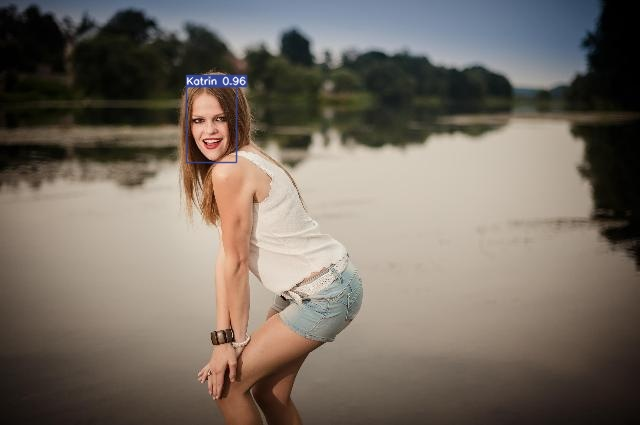

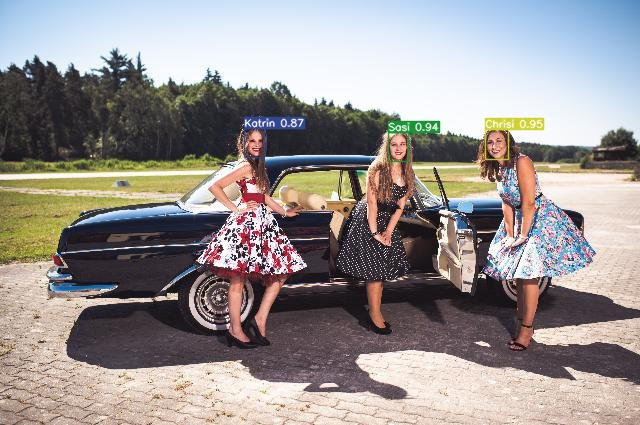

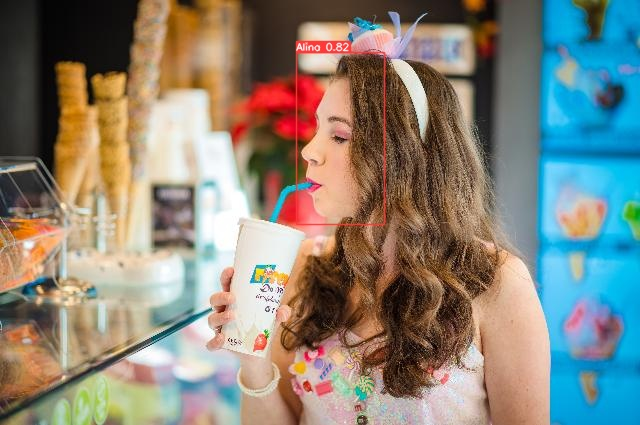

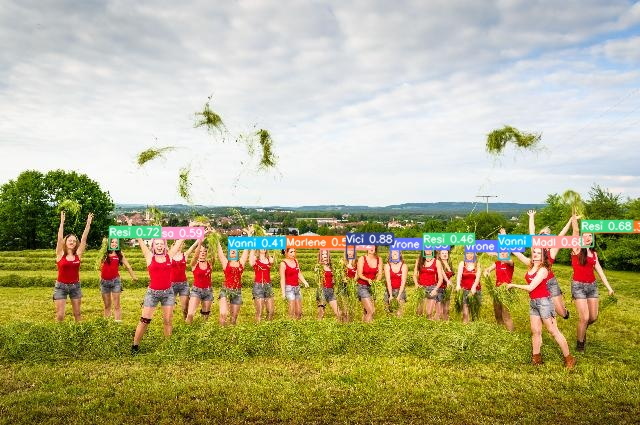

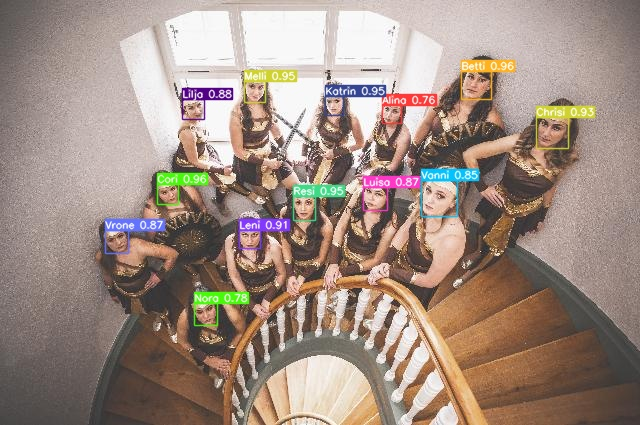

...

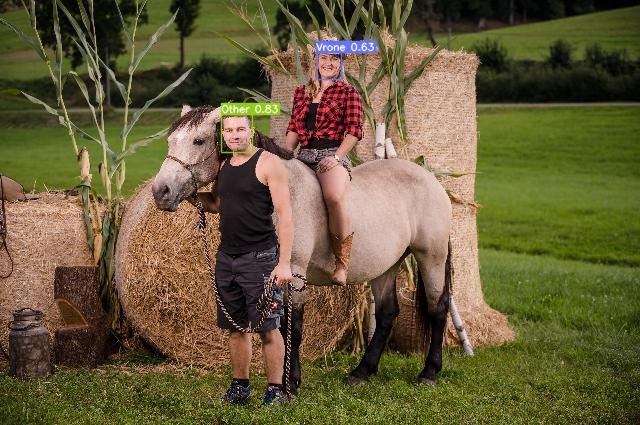

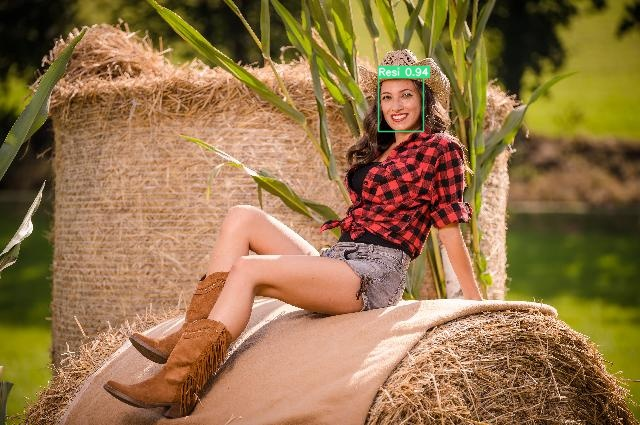

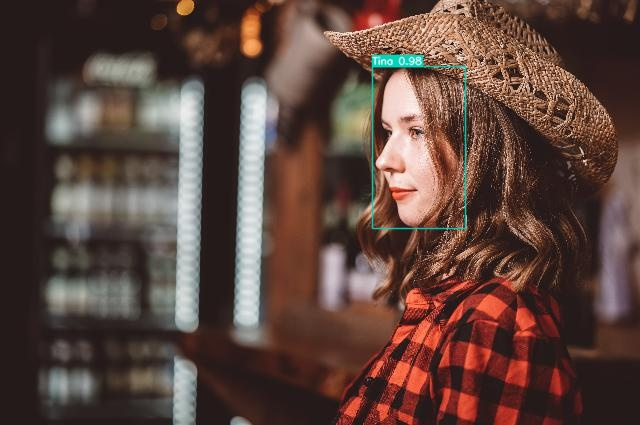

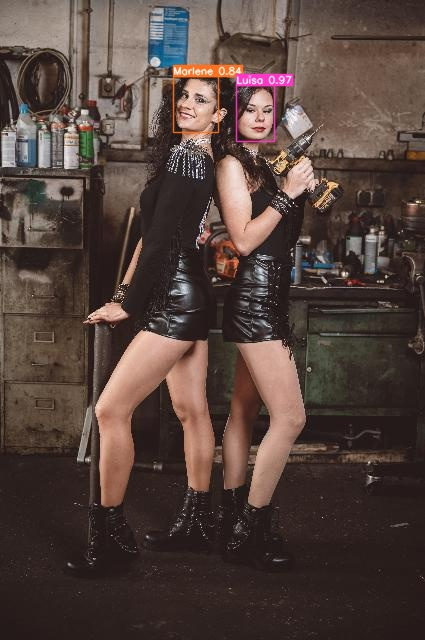

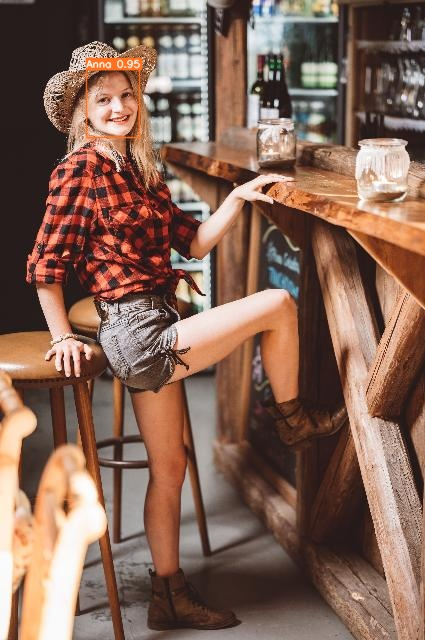

In [45]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict4_conf30/*.jpg'):
  display(Image(filename=image_path, height=600))
  print()

In [20]:
 def plot_one_box(x, img, color=None, label=None, line_thickness=3):
     # Plots one bounding box on image img
     tl = line_thickness or round(0.002 * (img.shape[0] + img.shape[1]) / 2) + 1  # line/font thickness
     color = color or [random.randint(0, 255) for _ in range(3)]
     c1, c2 = (int(x[0]), int(x[1])), (int(x[2]), int(x[3]))
     cv2.rectangle(img, c1, c2, color, thickness=tl, lineType=cv2.LINE_AA)
     if label:
         tf = max(tl - 1, 1)  # font thickness
         t_size = cv2.getTextSize(label, 0, fontScale=tl / 3, thickness=tf)[0]
         c2 = c1[0] + t_size[0], c1[1] - t_size[1] - 3
         cv2.rectangle(img, c1, c2, color, -1, cv2.LINE_AA)  # filled
         cv2.putText(img, label, (c1[0], c1[1] - 2), 0, tl / 3, [225, 255, 255], thickness=tf, lineType=cv2.LINE_AA)


 def plot_one_box_PIL(box, img, color=None, label=None, line_thickness=None):
     img = Image.fromarray(img)
     draw = ImageDraw.Draw(img)
     line_thickness = line_thickness or max(int(min(img.size) / 200), 2)
     draw.rectangle(box, width=line_thickness, outline=tuple(color))  # plot
     if label:
         fontsize = max(round(max(img.size) / 40), 12)
         font = ImageFont.truetype("Arial.ttf", fontsize)
         txt_width, txt_height = font.getsize(label)
         draw.rectangle([box[0], box[1] - txt_height + 4, box[0] + txt_width, box[1]], fill=tuple(color))
         draw.text((box[0], box[1] - txt_height + 1), label, fill=(255, 255, 255), font=font)
     return np.asarray(img)


image 1/1 /content/Face_Recognition-4/test/images/Z61_2110_jpg.rf.fa50e15711fe3bdbbf2699b65bfc5cb4.jpg: 448x640 1 Alina, 1 Anita, 1 Betti, 2 Chrisis, 1 Feli, 1 Judith, 1 Katrin, 1 Leni, 1 Marlene, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 28.3ms
Speed: 1.5ms preprocess, 28.3ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


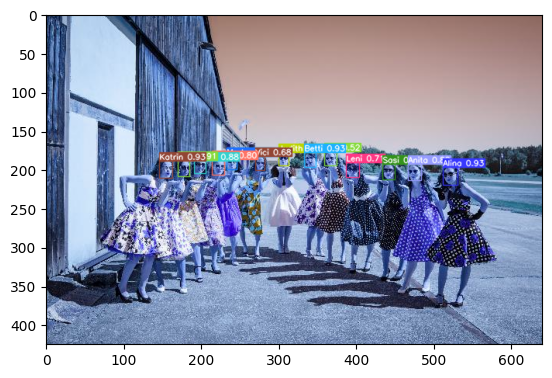

Bilder mit Data Augmentation

In [46]:
#image wihtout data augmentation
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="HZ0zIRYpPJF2UWyewNIa")
project = rf.workspace("yolocustomdataset").project("face_recognition-shzau")
version = project.version(3)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.2.2, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Face_Recognition-3 in yolov8:: 100%|██████████| 5198/5198 [00:01<00:00, 5181.09it/s]


In [48]:
!yolo task=detect mode=train model=yolov8m.pt data={dataset.location}/data.yaml epochs=20 imgsz=640


Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/Face_Recognition-3/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

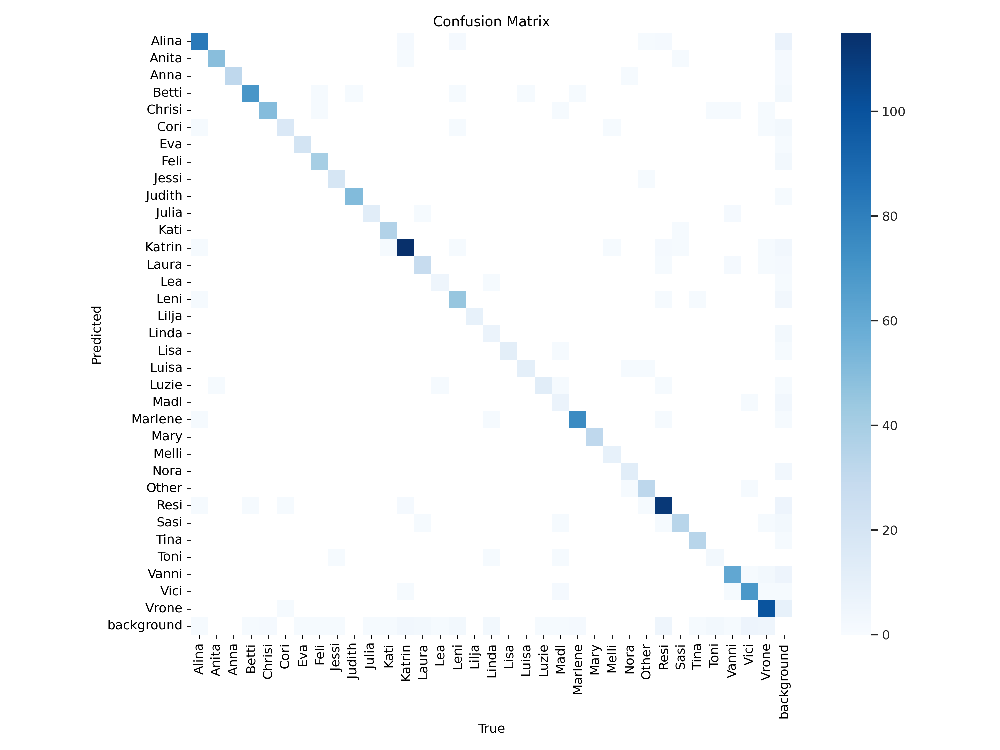

In [49]:
Image(filename=f'/content/runs/detect/train3/confusion_matrix.png', width=600)


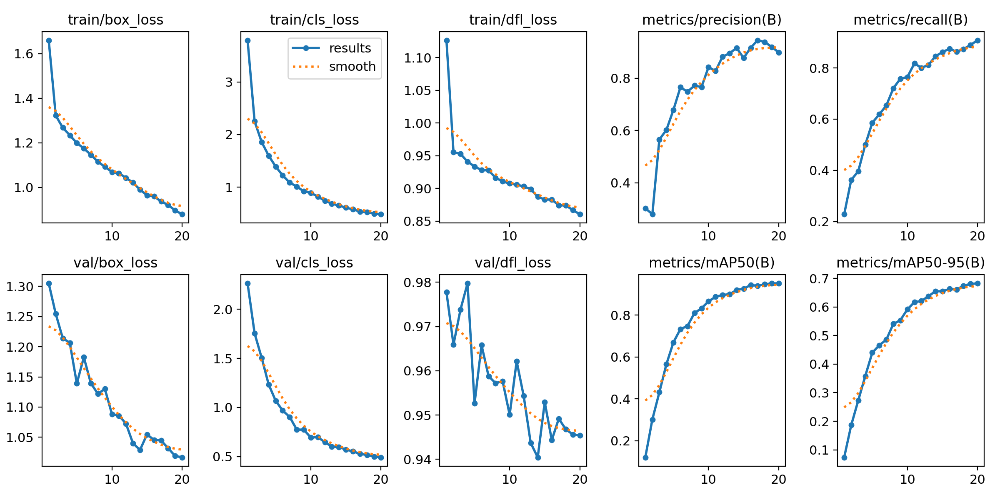

In [50]:
Image(filename=f'/content/runs/detect/train3/results.png',width=600)

In [51]:
!yolo task=detect mode=val model=/content/runs/detect/train3/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25859446 parameters, 0 gradients, 78.8 GFLOPs
val: Scanning /content/Face_Recognition-3/valid/labels.cache... 233 images, 0 backgrounds, 0 corrupt: 100% 233/233 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 15/15 [00:13<00:00,  1.07it/s]
                   all        233       1432      0.903      0.909      0.951      0.681
                 Alina        233         89      0.904      0.966      0.973      0.724
                 Anita        233         50      0.926       0.98      0.986      0.687
                  Anna        233         31      0.939      0.995      0.993       0.64
                 Betti        233         72       0.92      0.952       0.98      0.704
                Chrisi        233         52      0.941      0.962      0.985      0.692
                  Cori        233        

In [52]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.3 source='/content/Face_Recognition-3/test/images' line_width=1

Ultralytics YOLOv8.2.2 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25859446 parameters, 0 gradients, 78.8 GFLOPs

image 1/117 /content/Face_Recognition-3/test/images/Z61_2110_jpg.rf.fa50e15711fe3bdbbf2699b65bfc5cb4.jpg: 448x640 1 Alina, 1 Anita, 1 Betti, 2 Chrisis, 1 Feli, 1 Judith, 1 Katrin, 1 Leni, 1 Marlene, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 114.5ms
image 2/117 /content/Face_Recognition-3/test/images/Z61_2111_jpg.rf.5a3b9c02b91113bca8e5df8093fec182.jpg: 448x640 1 Alina, 1 Anita, 2 Bettis, 1 Chrisi, 1 Judith, 1 Katrin, 1 Leni, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 27.3ms
image 3/117 /content/Face_Recognition-3/test/images/Z61_2116_jpg.rf.4fd04d0ed977869b2682fc0cca72c8da.jpg: 448x640 1 Alina, 1 Anita, 1 Betti, 1 Chrisi, 1 Feli, 1 Judith, 1 Katrin, 1 Leni, 1 Marlene, 1 Resi, 1 Sasi, 1 Vici, 1 Vrone, 27.2ms
image 4/117 /content/Face_Recognition-3/test/images/Z61_2121_jpg.rf.36d8427b3548a6a57bf104f438066659.jpg: 448x640 1 Alina, 1 Anita, 1 

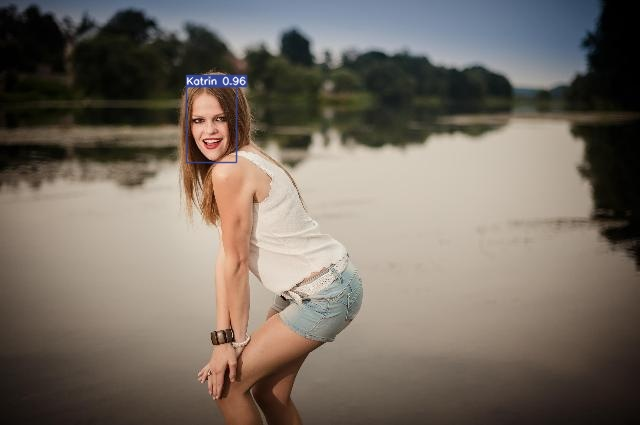

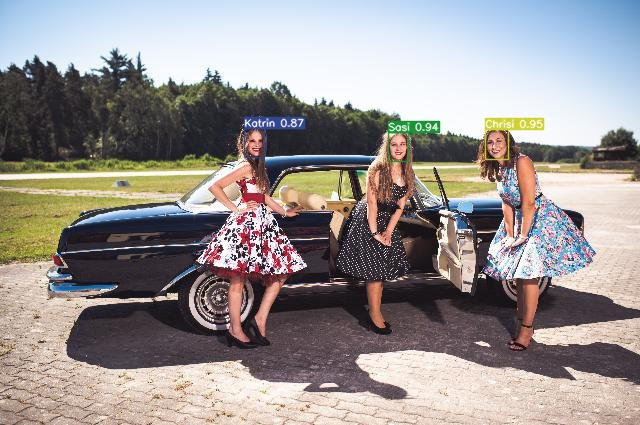

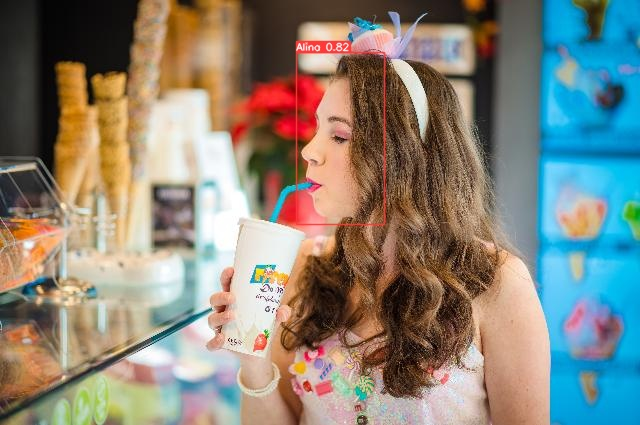

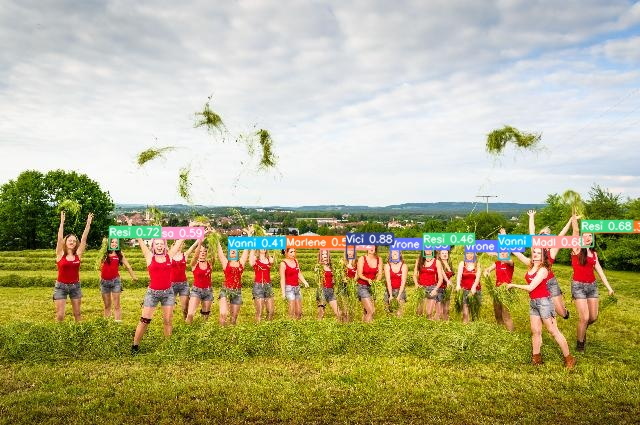

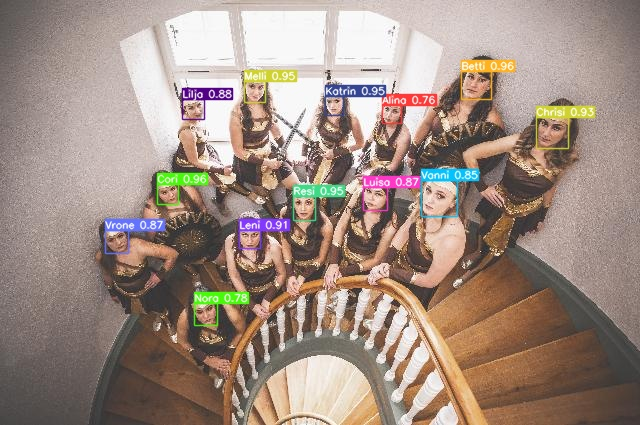

...

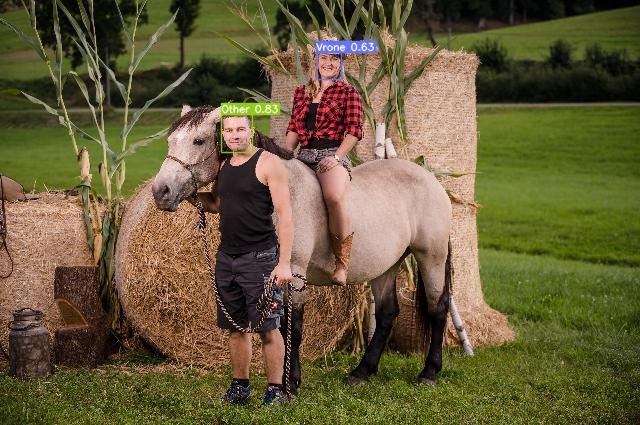

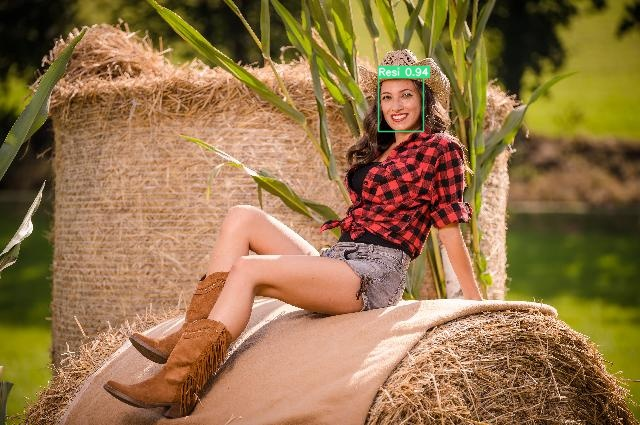

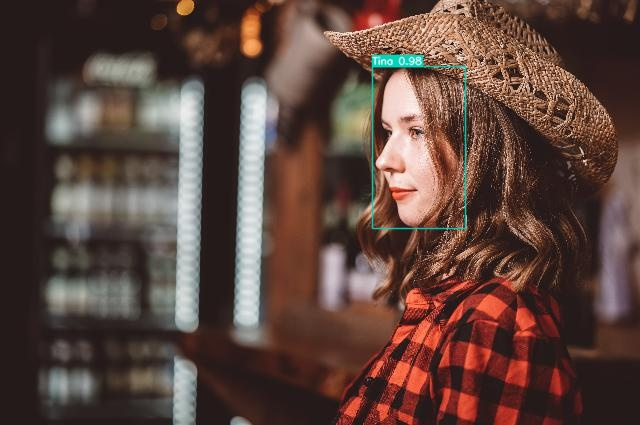

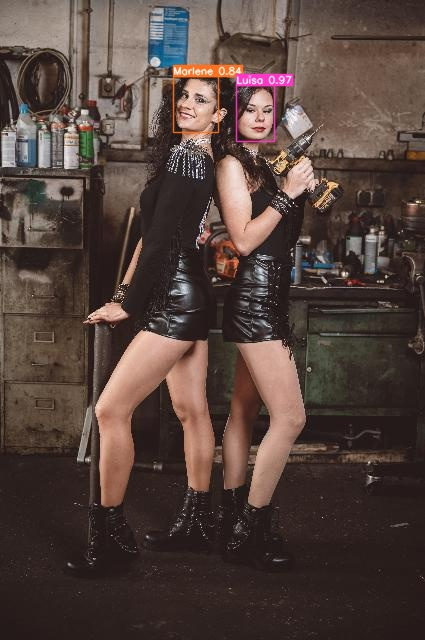

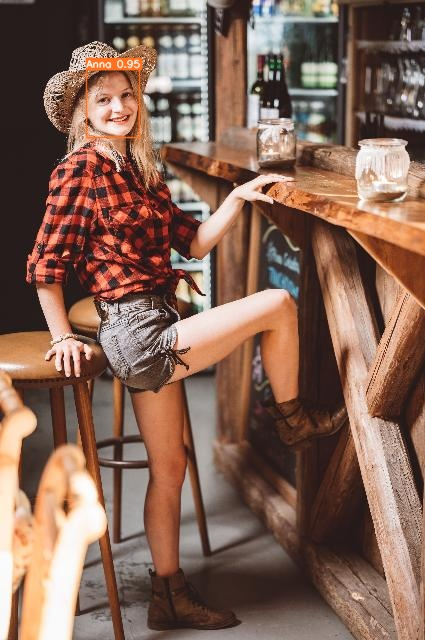

In [53]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg'):
  display(Image(filename=image_path, height=600))
  print()